[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179]
/Users/leapommier/Desktop/projet multi/tilt_0_180/carteSD120321_0000.tif
0:00:04.533846
avant (180, 1388, 1038)
apres (180, 694, 519)


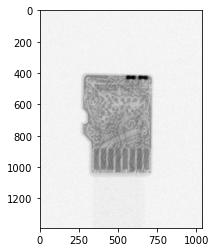

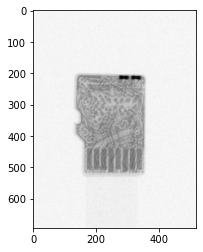

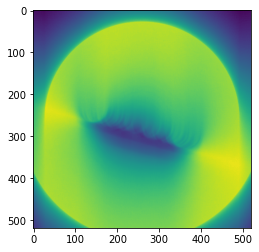

Animation size has reached 21010659 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


0:02:59.996281


In [2]:
#ALGORITHME FBP

#DEFINITION DES BIBLIOTHEQUES 
import tomopy
import dxchange
import matplotlib.pyplot as plt
import datetime
import time
#import logging
#logging.basicConfig(level=logging.INFO)
from imagestacks import create_animation
from IPython.core.display import HTML


#Definir les images à traiter
fname = '/Users/leapommier/Desktop/projet multi/tilt_0_180/carteSD120321_0000.tif'
ind = [i for i in range(180)] 
print(ind)
print(fname)
start = datetime.datetime.now()
proj = dxchange.reader.read_tiff_stack(fname, ind)
end = datetime.datetime.now() 
duree = end - start #Pour mesurer le temps mis pour effectuer la ligne proj
print(duree)


#diminuer la taille des images pour diminuer le temps d'execution
print('avant',proj.shape)
down = tomopy.misc.morph.downsample(proj, level=1, axis=1)#axe 1 lignes: faire la moyenne des pixels 2 à 2
down = tomopy.misc.morph.downsample(down, level=1, axis=2)# axe 2 colonnes: faire la moyenne des pixels 2 à 2
#Avec axe 0 on aurait pris l'image complète qu'on aurait moyener avec tous les tilts ce qui aurait eu un rendu flou
print('apres',down.shape)


#afficher la  1ere image avant downsampling
image0 = proj[0, :, :]#image zéro, on prend tous les pixels horizontaux et verticaux: toute la matrice des pixels
plt.imshow(image0, cmap='Greys_r')
plt.show()


#afficher la  1ere image apres downsampling
image0 = down[0, :, :]
plt.imshow(image0, cmap='Greys_r')
plt.show()

#affiche toutes les images avec l'animation  
anim2 = create_animation(down, size=4)
display(HTML(anim2.to_jshtml()))


#normaliser avec loi log pour loi de beer lambert
norm = tomopy.prep.normalize.minus_log(down, ncore=None, out=None)


#afficher la  1ere image normalisee
image0 = norm[0, :, :]
#plt.imshow(image0, cmap='Greys_r')
#plt.show()


ang = tomopy.angles(180) # Genère un espaces d'angles de 0° à 1°


#anim2 = create_animation(norm, size=4)
#display(HTML(anim2.to_jshtml()))

#definir le centre de rotation
rot_center = tomopy.find_center(norm, ang, init=None, ind=0, tol=0.5)
start = datetime.datetime.now()

# Reconstruction objet avec l'algorithme fbp.
# Mettre le filtre Hamming dans le filter_name pour atténuer les hautes fréquences
#Autre filtre qui peuvent etre utilisé : Hann,cos... 
rec = tomopy.recon(down, ang,center=rot_center, algorithm='fbp',filter_name='hamming') 



plt.imshow(rec[256,:,:])
plt.show()

#Affiche les images reconstruites avec l'animation
anim2 = create_animation(rec, size=4)
display(HTML(anim2.to_jshtml()))
end = datetime.datetime.now()
duree = end - start
duree
print(duree)